# Set Validation data

In [1]:
# from google.colab import drive
# drive.mount('/gdrive')

In [1]:
!git clone https://github.com/JungOhLee/bonemeta_model.git ./git_clone
!mv  -v ./git_clone/* .

fatal: destination path './git_clone' already exists and is not an empty directory.
mv: cannot stat './git_clone/*': No such file or directory


In [2]:
!ls /root/share/bone_segmentation

images	images4  images_1300300  labels  logs  models  predict


In [3]:
BASE_DIR = '/root/share/bone_segmentation/'
BATCH_SIZE = 32
NUM_WORKERS = 16
IMG_FOLDER_NAME = 'images_1300300'

In [4]:
def adjust_window(image, window):
    width = window[0]
    level = window[1]
    upper = level+width/2
    lower = level-width/2
    copied_image = image.copy()
    copied_image[copied_image<lower] = lower
    copied_image[copied_image>upper] = upper
    copied_image = copied_image-lower
    return (copied_image/(upper-lower)*255).round().astype(np.uint8)

In [5]:
import multiprocessing 
import os
import numpy as np
import time
from multiprocessing import Pool
multiprocessing.cpu_count()

48

In [5]:
FROM_FOLDER = 'images'
TO_FOLDER = IMG_FOLDER_NAME
os.makedirs(os.path.join(BASE_DIR, TO_FOLDER), exist_ok=True)

def wrapper(arg):
    return adjust_and_save(arg)

def adjust_and_save(file):
  file_path = os.path.join(BASE_DIR, FROM_FOLDER, file)
  npy_img = np.load(file_path)
  adjusted_img = adjust_window(npy_img, (1300, 300))
  np.save(os.path.join(BASE_DIR, TO_FOLDER, file), adjusted_img)

file_list = os.listdir(f'/root/share/bone_segmentation/{FROM_FOLDER}')

t = time.perf_counter()

pool = Pool(40)
results = pool.map(wrapper, file_list)
pool.close()
pool.join()

elapsed_time = time.perf_counter() - t
elapsed_time

125.20854413998313

# Check Images

In [6]:
import matplotlib.pyplot as plt

def slice_img(img, offset, end, interval):
  if end is None:
    end = len(img)
  else: 
    if end > len(img): 
      end = len(img)
    if end <= offset:
      end = offset + 1
  return img[offset:end:interval]

def show_numpy_img(np_img, offset=0, end=None, interval=5, title=''): 
  sliced_img = slice_img(np_img, offset, end, interval)

  figsize_per_img = 3
  num_col = 5
  num_row = int(np.ceil(sliced_img.shape[0] / num_col))
  # fig, axs = plt.subplots(num_row, num_col, figsize = (figsize_per_img*num_col, figsize_per_img*num_row))
  plt.figure(figsize=(figsize_per_img*num_col, figsize_per_img*num_row))
  for i, img in enumerate(sliced_img):
    if i >= num_col*num_row:
      continue
    # axs[i].imshow(img)
    plt.subplot(num_row, num_col, i+1)
    plt.imshow(img, 'gray')
    # plt.title()
  plt.suptitle(title)
  plt.tight_layout()
  plt.show()


# npy image windowing 하기
def adjust_window(image, window):
    width = window[0]
    level = window[1]
    upper = level+width/2
    lower = level-width/2
    copied_image = image.copy()
    copied_image[copied_image<lower] = lower
    copied_image[copied_image>upper] = upper
    copied_image = copied_image-lower
    return (copied_image/(upper-lower)*255).round().astype(np.uint8)

#npy image 정보 보여주기 
def show_img_info(np_img):
  print('Shape:', np_img.shape)
  print('DType:', np_img.dtype)
  print('Max:', np_img.max())
  print('Min:', np_img.min())
  print(np_img)


#npy image, npy label 
def plot_img_and_label(np_img, label, interval = 5, offset = 0, end=None, figsize_per_image = 5):
  sliced_img = slice_img(np_img, offset, end, interval)
  sliced_label = slice_img(label, offset, end, interval)
  
  num_row = len(sliced_img)
  num_col = 2

  plt.figure(figsize=(figsize_per_image*num_col, figsize_per_image*num_row))

  for i in range(0, num_row):
    plt.subplot(num_row, num_col, i*num_col+1)
    tissue_image = sliced_img[i]
    plt.imshow(tissue_image, 'gray')

    plt.subplot(num_row, num_col, i*num_col+2)
    mask = sliced_label[i]
    label_on_tissue = sitk.LabelMapContourOverlay(sitk.Cast(sitk.GetImageFromArray(mask), sitk.sitkLabelUInt8), sitk.GetImageFromArray(tissue_image), opacity=0.7, contourThickness=[2,2], colormap=(0,255,0))
    plt.imshow(sitk.GetArrayFromImage(label_on_tissue), 'gray')

  plt.tight_layout()
  plt.show()

In [7]:
IMG_DIR = os.path.join(BASE_DIR, IMG_FOLDER_NAME)
LABEL_DIR = os.path.join(BASE_DIR, 'labels')

IMG_FILES = os.listdir(IMG_DIR)
LABEL_FILES = os.listdir(LABEL_DIR)

def get_img_path(case): 
  return os.path.join(IMG_DIR, case)

def get_original_img_path(case):
  return os.path.join(BASE_DIR, 'images', case)
    

def get_label_path(case):
  return os.path.join(LABEL_DIR, case)

set(IMG_FILES).issubset(LABEL_FILES)
# '000273_20190531_chest.npy' - no label for this case

False

In [8]:
get_img_path(IMG_FILES[4])

'/root/share/bone_segmentation/images_1300300/BH059_20201013_abdomen.npy'

In [9]:
def get_numpy_img(filename):
    path = get_img_path(filename)
    return np.load(path)

def get_original_numpy_img(filename):
    path = get_original_img_path(filename)
    return np.load(path)

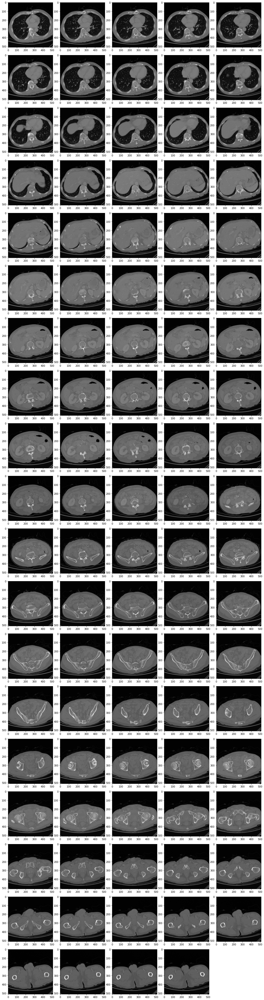

In [10]:
show_numpy_img(get_original_numpy_img(IMG_FILES[4]))

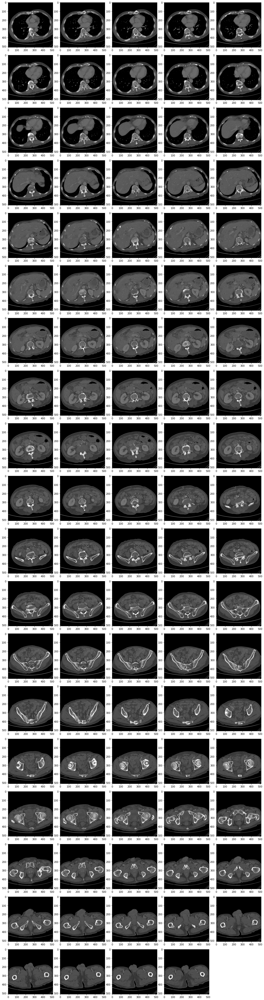

In [11]:
show_numpy_img(get_numpy_img(IMG_FILES[4]))

# Set Models

In [10]:
import os
from torch import nn

In [11]:
MODEL_TO_LOAD = 'bonesegmentation_fn_0_win1300300_model_epoch45'

In [12]:
MODEL_FOLDER = os.path.join(BASE_DIR, 'models')
MODEL_PATH = os.path.join(MODEL_FOLDER, MODEL_TO_LOAD)

In [13]:
import torch
USE_CUDA = torch.cuda.is_available()
DEVICE = torch.device("cuda" if USE_CUDA else "cpu")

In [14]:
from model import UNetWrapper, SegmentationAugmentation
from torch.optim import SGD, Adam
import logging
log = logging.getLogger("Unet")
# log.setLevel(logging.WARN)
# log.setLevel(logging.INFO)
log.setLevel(logging.DEBUG)

def initModel():
    segmentation_model = UNetWrapper(
        in_channels=7,
        n_classes=1,
        depth=3,
        wf=4,
        padding=True,
        batch_norm=True,
        up_mode='upconv',
    )

    # augmentation_model = SegmentationAugmentation(**self.augmentation_dict)

    if USE_CUDA:
        log.info("Using CUDA; {} devices.".format(torch.cuda.device_count()))
        if torch.cuda.device_count() > 1:
            segmentation_model = nn.DataParallel(segmentation_model)
            # augmentation_model = nn.DataParallel(augmentation_model)
        segmentation_model = segmentation_model.to(DEVICE)
        # augmentation_model = augmentation_model.to(DEVICE)

    return segmentation_model #, augmentation_model

In [15]:
model = initModel()

2021-08-09 21:22:36,554 INFO     pid:22 Unet:023:initModel Using CUDA; 3 devices.


In [16]:
seg_dict = torch.load(MODEL_PATH, map_location='cpu')
if torch.cuda.device_count() > 1:
  model.module.load_state_dict(seg_dict['model_state'])
else:
  model.load_state_dict(seg_dict['model_state'])

In [17]:
model.eval()

DataParallel(
  (module): UNetWrapper(
    (input_batchnorm): BatchNorm2d(7, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (unet): UNet(
      (down_path): ModuleList(
        (0): UNetConvBlock(
          (block): Sequential(
            (0): Conv2d(7, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (1): ReLU()
            (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (4): ReLU()
            (5): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          )
        )
        (1): UNetConvBlock(
          (block): Sequential(
            (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (1): ReLU()
            (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (3): Conv2d(32, 32, kernel_size=(3, 3), stride=

In [18]:
for p in model.parameters():
  p.requires_grad_(False)

# Set data

In [19]:
from torch.utils.data import Dataset

from torch.utils.data import Dataset
from augmentation import get_transform
import pandas as pd
import numpy as np

class NewDataset(Dataset):
  def __init__(self, file_names, num_slices):
    self.file_names = file_names
    self.num_slices = num_slices
    self.npy_img_list = []
    self.indexing_df = pd.DataFrame({'case':[],'case_idx':np.empty(0,dtype=int),'internal_idx':np.empty(0,dtype=int)})
    self.set_npy_list() 

  def set_npy_list(self):
    for i, file in enumerate(self.file_names): 
      img_path = get_img_path(file)
      npy_img = np.load(img_path)
      
      length = len(npy_img)
      indexing = pd.DataFrame({'case':[file]*length,'case_idx':[i]*length,'internal_idx':range(length)})
      self.indexing_df = self.indexing_df.append(indexing, ignore_index=True)

      padded = np.zeros(shape = (npy_img.shape[0] + 2 * self.num_slices, npy_img.shape[1], npy_img.shape[2]))
      padded[self.num_slices: self.num_slices + npy_img.shape[0]] = npy_img

      self.npy_img_list.append(padded)

  def __len__(self):
    return len(self.indexing_df)

  def __getitem__(self, idx):
    selected_case = self.indexing_df.iloc[idx]
    case_idx = selected_case.case_idx
    internal_idx = selected_case.internal_idx

    img = self.npy_img_list[case_idx]

    data = img[internal_idx: internal_idx + (2 * self.num_slices) + 1].astype(np.float32)
    return data, 0

In [20]:
len(IMG_FILES)

342

In [24]:
USED_FILES = ['000019_20181018_chest.npy', '000019_20190613_chest.npy', '000232_20190401_abdomen.npy', '000232_20190423_chest.npy', '000242_20190401_abdomen.npy', '000242_20190409_chest.npy', '000332_20191001_abdomen.npy', '000332_20191025_chest.npy', '000376_20200101_abdomen.npy', '000376_20200114_chest.npy', 'BH008_20190701_abdomen.npy', 'BH008_20190701_chest.npy', 'BH009_20180301_abdomen.npy', 'BH009_20180301_chest.npy', 'BH010_20161101_abdomen.npy', 'BH010_20161101_chest.npy', 'BH012_20180401_abdomen.npy', 'BH012_20180401_chest.npy', 'BH023_20191101_abdomen.npy', 'BH023_20191101_chest.npy', 'BH024_20190501_abdomen.npy', 'BH024_20190501_chest.npy', 'BH032_20180701_abdomen.npy', 'BH032_20180701_chest.npy', 'BH021_20181001_abdomen.npy', 'BH021_20181001_chest.npy', '000363_20191201_abdomen.npy', '000363_20191222_chest.npy', '000193_20190114_chest.npy', '000091_20180504_chest.npy', '000268_20190501_abdomen.npy', 'SN028_20160801_chest.npy', 'BH017_20191201_chest.npy', '000258_20190501_abdomen.npy', '000309_20190801_abdomen.npy', '000069_20180319_chest.npy', 'SN013_20190401_chest.npy', '000350_20191001_abdomen.npy', 'BH028_20190801_chest.npy', '000011_20181207_chest.npy', '000236_20190401_abdomen.npy', '000300_20190801_abdomen.npy', 'BH022_20190101_chest.npy', '000314_20190901_abdomen.npy', '000266_20190501_abdomen.npy', '000269_20190601_abdomen.npy', 'BH035_20191101_GU Kidney & bladder CT (3D).npy', '000234_20190401_abdomen.npy', '000010_20181214_chest.npy', '000315_20190901_abdomen.npy', '000273_20190501_abdomen.npy', '000080_20180911_chest.npy', 'BH020_20191201_chest.npy', 'BH025_20191101_abdomen.npy', '000324_20190910_chest.npy', 'SN054_20170201_chest.npy', '000298_20190726_chest.npy', 'BH013_20191001_chest.npy', '000085_20180829_chest.npy', '000272_20190614_chest.npy', '000352_20191001_abdomen.npy', '000247_20190501_abdomen.npy', '000022_20180830_chest.npy', '000025_20180808_chest.npy', '000002_20180829_chest.npy', 'BH030_20160101_T-L spine (3D).npy', '000354_20191001_abdomen.npy', 'SN015_20190901_chest.npy', 'SN025_20200401_chest.npy', '000282_20190701_abdomen.npy', 'SN016_20190901_chest.npy', '000005_20181202_chest.npy', '000305_20190801_abdomen.npy', '000301_20190827_chest.npy', '000224_20190228_chest.npy', 'BH014_20181201_chest.npy', 'BH018_20190801_chest.npy', '000307_20190806_chest.npy', '000288_20190701_abdomen.npy', 
#               '000330_20191001_abdomen.npy', 
              'SN036_20190601_chest.npy', '000325_20190919_chest.npy', '000244_20190501_abdomen.npy', '000081_20180911_chest.npy',
             'BH026_20190601_abdomen.npy', '000260_20190522_chest.npy', '000310_20190801_abdomen.npy', 'BH036_20180301_GU Kidney & bladder CT (3D).npy', 'BH004_20191101_chest.npy', '000021_20181227_chest.npy', '000262_20190501_abdomen.npy', '000355_20190901_abdomen.npy', '000162_20180131_chest.npy', '000212_20190324_chest.npy', '000048_20190501_abdomen.npy', 'BH015_20190101_chest.npy', 'SN005_20191101_chest.npy', 'BH029_20200101_chest.npy', '000331_20190901_abdomen.npy']
len(USED_FILES)

98

In [22]:
VALID_FILES = list(set(IMG_FILES)-set(USED_FILES))
len(VALID_FILES)

244

In [25]:
val_dataset = NewDataset(USED_FILES, num_slices=3)

In [26]:
val_dataset.indexing_df.iloc[5]

case            000019_20181018_chest.npy
case_idx                                0
internal_idx                            5
Name: 5, dtype: object

In [27]:
from torch.utils.data import DataLoader 

def initValDl(val_ds, batch_size = BATCH_SIZE):
    val_dl = DataLoader(
        val_ds,
        batch_size=batch_size,
        num_workers=NUM_WORKERS,
        pin_memory=USE_CUDA,
        shuffle=False
    )
    return val_dl

In [28]:
val_dl = initValDl(val_dataset)

# Predict and Save

In [29]:
PRED_DIR = os.path.join(BASE_DIR, 'predict', MODEL_TO_LOAD)

In [30]:
def predict_and_save(batch_imgs, i_batch):
    preds = model(batch_imgs)
    pred_labels = (preds > 0.5).type(torch.uint8)
    for i, pred_label in enumerate(pred_labels):
        i_sample = i_batch* BATCH_SIZE + i
        sample_info = val_dataset.indexing_df.iloc[i_sample]
        case_name = sample_info.case.split('.')[0]
        saving_dir = os.path.join(PRED_DIR, case_name)
        os.makedirs(saving_dir, exist_ok=True)
        saving_path = os.path.join(saving_dir, f'{sample_info.internal_idx:04}.npy')
        np.save(saving_path, pred_label.to('cpu').numpy().astype(bool))

In [31]:
for i_batch, sample_batched in enumerate(val_dl):
    batch_imgs, _ = sample_batched
    input_imgs = batch_imgs.to(DEVICE, non_blocking=True)
    predict_and_save(input_imgs, i_batch)

In [ ]:
plt.imshow(np.load(f'{PRED_DIR}/000009_20180417_chest/0230.npy')[0])

# Visualize

In [65]:
import SimpleITK as sitk

     |████████████████████████████████| 48.4 MB 229 kB/s  eta 0:00:01     |█████████████████████████▉      | 39.1 MB 20.9 MB/s eta 0:00:01


In [61]:
def plot_img_and_label(np_img, label, interval = 5, offset = 0, end=None, figsize_per_image = 5):
  sliced_img = slice_img(np_img, offset, end, interval)
  sliced_label = slice_img(label, offset, end, interval)
  
  num_row = len(sliced_img)
  num_col = 2

  plt.figure(figsize=(figsize_per_image*num_col, figsize_per_image*num_row))

  for i in range(0, num_row):
    plt.subplot(num_row, num_col, i*num_col+1)
    tissue_image = sliced_img[i]
    plt.imshow(tissue_image, 'gray')

    plt.subplot(num_row, num_col, i*num_col+2)
    mask = sliced_label[i]
    label_on_tissue = sitk.LabelMapContourOverlay(sitk.Cast(sitk.GetImageFromArray(mask), sitk.sitkLabelUInt8), sitk.GetImageFromArray(tissue_image), opacity=0.7, contourThickness=[2,2], colormap=(0,255,0))
    plt.imshow(sitk.GetArrayFromImage(label_on_tissue), 'gray')

  plt.tight_layout()
  plt.show()

In [55]:
def load_and_join_npys(base_dir, case_name):
    npy_dir = os.path.join(base_dir, case_name)
    npy_file_list = glob.glob(f'{npy_dir}/*.npy')
    npy_file_list.sort()
    npys = [np.load(file_path) for file_path in npy_file_list]
    joined_npys = np.concatenate(npys, axis=0)
    return joined_npys

In [109]:
img = get_numpy_img('000009_20180417_chest.npy')

In [110]:
label = load_and_join_npys(PRED_DIR, '000009_20180417_chest')

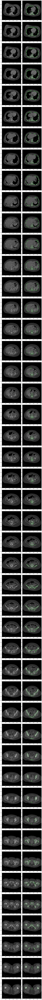

In [111]:
plot_img_and_label(img, label.astype(np.uint8))

In [95]:
BASE_DIR

'/root/share/bone_segmentation/'

In [96]:
NIFTI_DIR = os.path.join(BASE_DIR, 'predict', 'nifti', MODEL_TO_LOAD)
os.makedirs(NIFTI_DIR, exist_ok = True)

In [97]:
case_names = os.listdir(PRED_DIR)

def save_label_as_nifti(case_name, target_dir):
    label = load_and_join_npys(PRED_DIR, case_name)
    label_as_int = label.astype(np.uint8)
    sitk_img = sitk.GetImageFromArray(label_as_int)
    saving_path = os.path.join(target_dir, f'{case_name}.nii')
    sitk.WriteImage(sitk_img, saving_path)

In [100]:
def wrapper(arg):
    return save_label_as_nifti(*arg)

args = [(case, NIFTI_DIR) for case in case_names]

t = time.perf_counter()

pool = Pool(40)
results = pool.map(wrapper, args)
pool.close()
pool.join()

elapsed_time = time.perf_counter() - t
elapsed_time

59.01254114499898

In [104]:
label_nii = sitk.ReadImage(f'{NIFTI_DIR}/000009_20180417_chest')
label_from_nii = sitk.GetArrayFromImage(label_nii)
label_from_nii.dtype

dtype('uint8')

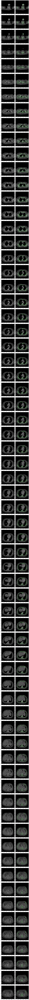

In [106]:
plot_img_and_label(img, label_from_nii)

In [108]:
VALID_FILES[5]

'SN028_20160801_abdomen.npy'